In [61]:
import numpy as np
import pandas as pd
import csv            #importing this
from scipy import stats

from sklearn.decomposition import PCA

# Visualisation libraries
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots

# Machine learning models
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

# Evaluation metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import matthews_corrcoef


# Sustanability impact of each library
!pip install codecarbon
import codecarbon

DataFrame with the values imported as type int16 bytes to reduce the size

In [7]:
df = pd.read_csv('covtype.csv', dtype='int16')  #5523 is the highest value so 16 bytes is enough to represent it
df

,2596,51,3,258,0,510,221,232,148,6279,...,0.34,0.35,0.36,0.37,0.38,0.39,0.40,0.41,0.42,5
0,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
1,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
2,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
3,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5
4,2579,132,6,300,-15,67,230,237,140,6031,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
581006,2396,153,20,85,17,108,240,237,118,837,...,0,0,0,0,0,0,0,0,0,3
581007,2391,152,19,67,12,95,240,237,119,845,...,0,0,0,0,0,0,0,0,0,3
581008,2386,159,17,60,7,90,236,241,130,854,...,0,0,0,0,0,0,0,0,0,3
581009,2384,170,15,60,5,90,230,245,143,864,...,0,0,0,0,0,0,0,0,0,3


Creating a list to assign dataframe columns with proper names

![Dataset details](../Dataset/data_details.png)

In [8]:
#Column names of the first 14 columns
column_names = ['elevation', 'aspect', 'slope',
                'horizontal_distance_to_hydrology',
                'vertical_distance_to_hydrology',
                'horizontal_distance_to_roadways',
                'hillshade_9am', 'hillshade_noon', 'hillshade_3pm',
                'horizontal_distance_to_fire_points', 'wilderness_area1',
                'wilderness_area2', 'wilderness_area3','wilderness_area4']

# adding the 40 soil types column names
for i in range(1,41):
    column_names.append(f"soil_type{i}")

# adding the final target columns
column_names.append("cover_type")

print(column_names)

['elevation', 'aspect', 'slope', 'horizontal_distance_to_hydrology', 'vertical_distance_to_hydrology', 'horizontal_distance_to_roadways', 'hillshade_9am', 'hillshade_noon', 'hillshade_3pm', 'horizontal_distance_to_fire_points', 'wilderness_area1', 'wilderness_area2', 'wilderness_area3', 'wilderness_area4', 'soil_type1', 'soil_type2', 'soil_type3', 'soil_type4', 'soil_type5', 'soil_type6', 'soil_type7', 'soil_type8', 'soil_type9', 'soil_type10', 'soil_type11', 'soil_type12', 'soil_type13', 'soil_type14', 'soil_type15', 'soil_type16', 'soil_type17', 'soil_type18', 'soil_type19', 'soil_type20', 'soil_type21', 'soil_type22', 'soil_type23', 'soil_type24', 'soil_type25', 'soil_type26', 'soil_type27', 'soil_type28', 'soil_type29', 'soil_type30', 'soil_type31', 'soil_type32', 'soil_type33', 'soil_type34', 'soil_type35', 'soil_type36', 'soil_type37', 'soil_type38', 'soil_type39', 'soil_type40', 'cover_type']


In [9]:
df.columns = column_names     # replacing automatically generated numeric column names with proper column names
df

,elevation,aspect,slope,horizontal_distance_to_hydrology,vertical_distance_to_hydrology,horizontal_distance_to_roadways,hillshade_9am,hillshade_noon,hillshade_3pm,horizontal_distance_to_fire_points,...,soil_type32,soil_type33,soil_type34,soil_type35,soil_type36,soil_type37,soil_type38,soil_type39,soil_type40,cover_type
0,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
1,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
2,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
3,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5
4,2579,132,6,300,-15,67,230,237,140,6031,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
581006,2396,153,20,85,17,108,240,237,118,837,...,0,0,0,0,0,0,0,0,0,3
581007,2391,152,19,67,12,95,240,237,119,845,...,0,0,0,0,0,0,0,0,0,3
581008,2386,159,17,60,7,90,236,241,130,854,...,0,0,0,0,0,0,0,0,0,3
581009,2384,170,15,60,5,90,230,245,143,864,...,0,0,0,0,0,0,0,0,0,3


In [10]:
original_length = len(df)
original_length

581011

In [11]:
df.describe()

,elevation,aspect,slope,horizontal_distance_to_hydrology,vertical_distance_to_hydrology,horizontal_distance_to_roadways,hillshade_9am,hillshade_noon,hillshade_3pm,horizontal_distance_to_fire_points,...,soil_type32,soil_type33,soil_type34,soil_type35,soil_type36,soil_type37,soil_type38,soil_type39,soil_type40,cover_type
count,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,...,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000,581011.000000
mean,2959.365926,155.656988,14.103723,269.428236,46.418935,2350.149779,212.146033,223.318701,142.528253,1980.283828,...,0.090392,0.077716,0.002773,0.003255,0.000205,0.000513,0.026803,0.023762,0.015060,2.051465
std,279.984569,111.913733,7.488234,212.549538,58.295250,1559.254343,26.769909,19.768711,38.274561,1324.184340,...,0.286743,0.267725,0.052584,0.056957,0.014310,0.022641,0.161508,0.152307,0.121792,1.396500
min,1859.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2809.000000,58.000000,9.000000,108.000000,7.000000,1106.000000,198.000000,213.000000,119.000000,1024.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,2996.000000,127.000000,13.000000,218.000000,30.000000,1997.000000,218.000000,226.000000,143.000000,1710.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,3163.000000,260.000000,18.000000,384.000000,69.000000,3328.000000,231.000000,237.000000,168.000000,2550.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
max,3858.000000,360.000000,66.000000,1397.000000,601.000000,7117.000000,254.000000,254.000000,254.000000,7173.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 581011 entries, 0 to 581010
Data columns (total 55 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   elevation                           581011 non-null  int16
 1   aspect                              581011 non-null  int16
 2   slope                               581011 non-null  int16
 3   horizontal_distance_to_hydrology    581011 non-null  int16
 4   vertical_distance_to_hydrology      581011 non-null  int16
 5   horizontal_distance_to_roadways     581011 non-null  int16
 6   hillshade_9am                       581011 non-null  int16
 7   hillshade_noon                      581011 non-null  int16
 8   hillshade_3pm                       581011 non-null  int16
 9   horizontal_distance_to_fire_points  581011 non-null  int16
 10  wilderness_area1                    581011 non-null  int16
 11  wilderness_area2                    581011 non-null 

In [13]:
# To get a feel of the data a line chart is plotted
fig = px.line(df, x=df.index, y= df.columns, title='                     Covertype column values vs samples')
fig.show()

# 1. Preprocessing

### Dropping all rows with missing values

In [14]:
df = df.dropna()
len_after_na_drop = len(df)
print(f"The number of raws with missing values that have been dropped is {len_after_na_drop-original_length}")  # there should be none as the dataset obtained mentions that it has none

Eventhough all the columns are numeric, some of them are categorical and need not be normalised. This is provided by the by the dataset description.

=> Extracting the quantitative columns, that have continuously values.

In [15]:
# Extracting the quantiative columns, which are the first 10 columns
quantitative_columns = column_names[:10]   # the names of the columns are the numbers ranging from 0 to 54 in this project
print("The quantiative/continous columns are: ", quantitative_columns,'\n\nThe dataframe created from those columns is:')

# Creating a dataframe of the quantiative columns only
quantitative_columns_df = df[quantitative_columns]
quantitative_columns_df

=> Extracting the categorical columns.

In [16]:
# Extracting the categorical columns, which are the columns from index 10 - 54 of the column names list
categorical_columns = column_names[10:54]
print("The Categorical columns are: ", categorical_columns,'\n\nThe dataframe created from those columns is:')

# Creating a dataframe of the categorical columns only
categorical_columns_df = df[categorical_columns]   # creating a categorical dataframe
categorical_columns_df

Once the quantiative columns have been extracted, we can normalise the dataframe of the quantiative columns. It would meaning meaningless to normalise the categorical columns.

In [17]:
# Normalizing the quantitative columns and storing them in a new dataframe, quantitative_normalised_columns_df
quantitative_normalised_columns_df = stats.zscore(quantitative_columns_df)

# Updating the original dataframe with the normalised quantiative columns
for i in quantitative_columns:
    df[i] = quantitative_normalised_columns_df[i]

In [18]:
# Making a copy of the original dataframe to preserve the data as a reference

new_df = df.copy()     # a copy of the original dataframe
new_df

### Checking for outliers

Checking for outliers only on the quantitative / continues columns only using the BOX-WHISKER PLOT

In [19]:
np.arange(2,12)
quantitative_columns

In [ ]:
fig, axs = plt.subplots()
fig.set_size_inches(20,10)
plt.xticks(np.arange(2,12), quantitative_columns)
plt.xlabel("Columns")
plt.ylabel("standard deviation")
plt.title("Box Plot of the columns of the quantiative columns")
_=plt.boxplot(quantitative_normalised_columns_df, vert = True)

In [ ]:
quantitative_normalised_columns_df

From the box-whisker plot above it is clear that there are outliers in the data

In [ ]:
def IQR_outlier_handler(series_input):
    """ A function to return the indices of rows that contain outlier values of the series_input

    Args:
        series_input: a quantitative column that has continuous values

    Returns:
        a list of indices of values in series that are outliers
    """
    Q1 = series_input.quantile(0.25)
    Q3 = series_input.quantile(0.75)

    IQR = Q3 - Q1                      #IQR is interquartile range.

    lower_bound = Q1-1.1*IQR        # the common factor multiplied by IQR is 1.5 but we can contraol the values of k based on the standard deviation to not be tolerated
    higher_bound = Q3 + 1.1*IQR

    outlier_indices = list()  # a list to store indices of outlier values

    # a for loop to iterate over all values of a column and check for outlier values
    for k in range(len(series_input)):
        if ((series_input[k]> higher_bound) or (series_input[k]< lower_bound)):   # checking if a value is an outlier
            outlier_indices.append(k)

    return  outlier_indices

# Alternative code to find the indices of the rows that need to be dropped instead of IQR but directly by finding rows that exceed certain threshold

# outlier_detector = (quantitative_normalised_columns_df>1.5) | (quantitative_normalised_columns_df<-1.5)
# list_backup = list()
# for i in range(len(outlier_detector)):
#     if True in outlier_detector.iloc[i].values:
#         list_backup.append(i)

# len(list_backup)
# outlier_detector

In [ ]:
df_outlier_indices = list()  # a list to store the unique index number of all rows in the dataframe that contain outlier values, that are to be dropped later

# Iterating over every column and identifying the rows/ indices that contain outlier values
for i in quantitative_columns:
    series_instance = quantitative_normalised_columns_df[i]   # a series selected
    outlier_indexes = IQR_outlier_handler(series_instance)    # applying
    for ind in outlier_indexes:
        if ind not in df_outlier_indices:
            df_outlier_indices.append(ind)
print(f"According to the BOX-WHISKER plot and IQR detection the number of rows with outlier values is: {len(df_outlier_indices)}\n")
print(f"The outlier indices are: {df_outlier_indices}")

In [ ]:
new_df.drop(index=df_outlier_indices, inplace = True)
quantitative_normalised_columns_df.drop(index=df_outlier_indices, inplace = True)   #updating the quantiatitve_normalised_columns_df as well

len_after_outlier_drop = len(new_df)
print(f"--> {len_after_na_drop-len_after_outlier_drop} rows with outliers dropped have been dropped after BOX-WHISKER plot and IQR ")

In [ ]:
new_df

# 2. Exploratory Data Analysis

## Extensive Visualisation

- Visualisation of the quantitative columns.
- visualisation of the categorical columns.
- visualisation of the classes.

### 2.1 Class Labels

In [ ]:
class_labels = np.unique(new_df['cover_type'].values)
class_labels

In [ ]:
class_label1 = new_df.loc[new_df['cover_type']==1]
len_class_label1 = len(class_label1)
print(f"number of class label 1 is: {len_class_label1}")

class_label2 = new_df.loc[new_df['cover_type']==2]
len_class_label2 = len(class_label2)
print(f"number of class label 2 is: {len_class_label2}")

class_label3 = new_df.loc[new_df['cover_type']==3]
len_class_label3 = len(class_label3)
print(f"number of class label 3 is: {len_class_label3}")

class_label4 = new_df.loc[new_df['cover_type']==4]
len_class_label4 = len(class_label4)
print(f"number of class label 4 is: {len_class_label4}")

class_label5 = new_df.loc[new_df['cover_type']==5]
len_class_label5 = len(class_label5)
print(f"number of class label 5 is: {len_class_label5}")

class_label6 = new_df.loc[new_df['cover_type']==6]
len_class_label6 = len(class_label6)
print(f"number of class label 6 is: {len_class_label6}")

class_label7 = new_df.loc[new_df['cover_type']==7]
len_class_label7 = len(class_label7)
print(f"number of class label 7 is: {len_class_label7}")

In [ ]:
fig = px.bar(x=np.arange(1,8), y=np.array([len_class_label1,len_class_label2,len_class_label3,len_class_label4,len_class_label5,len_class_label6,len_class_label7]), text_auto='.2s', title="Plot of frequency of each class label ")
fig.show()

The data is not imbalanced, but different weights will be assigned to each class, according to their size, when evaluating the precision of a model.

### 2.2 Feature columns

#### 2.2.1 Visualizing the categorical columns separately due to their different meaning and values than the quantitative values

In [ ]:
fig, ax = plt.subplots()
fig.set_size_inches(20, 8)
_=plt.plot(categorical_columns_df, label = categorical_columns_df.columns)
_=plt.title("Categorical columns plot")
_=plt.xlabel("Categorical columns")
_=plt.ylabel("Corresponding values")
_=plt.legend()

- In the plot, the 44 categorical columns have only two values each, 0 (absence) and 1 (presence) of a feature, and that's why the lines line chart shows vertical lines transitioning between values 0 and 1.

- Some of the columns might have the same constant value throught the whole dataset.

- If such column/feature exists, then it will be dropped as it is meaningless in predicing the output if it is the same value throughout.

- Thus, categorical values need to be checked for such behavior.

In [ ]:
def constant_value_checker(series_to_be_checked):
    """A function that takes a series/column as an input and checks if it is a constant value througought all samples, to be used for categorical columns.

    Args:
        series (_type_): takes column values to be checked

    Returns:
        boolean _type_: returns True if it is a horizontal line, with constant value across all samples; it returns false otherwise.
    """
    is_flat = False
    if len(np.unique(series_to_be_checked))==1:   # if it has one value either 0 or 1 throught the whole dataset, then return true
        is_flat = True

    return is_flat

In [ ]:
columns_to_be_dropped = list()   # a list to store columns,meaningless, with constant values throughout all the samples

# a for loop to iterate over all the categorical columns one by one
for col in categorical_columns_df:

    is_it_flat = constant_value_checker(categorical_columns_df[col].values)  # calling the function constant_value_checker to check if all the values of a series are the same
    if is_it_flat:      # if so, then to be dropped later, we append the column name into the columns_to_be_dropped list
        columns_to_be_dropped.append(col)

print(f"There are {len(columns_to_be_dropped)} columns that have one value throught all the samples.\nThe colulmns names are: {columns_to_be_dropped}")

In [ ]:
# Dropping the categorical columns that have unchanging value from the new_df and the categorical_columns_df

new_df.drop( columns = columns_to_be_dropped, inplace = True )
categorical_columns_df = categorical_columns_df.drop( columns = columns_to_be_dropped, inplace = True )

In [ ]:
column_names

#### 2.2.2 Visualising quantiative columns, the first 10 columns

In [ ]:
# first row
fig, axes = plt.subplots(3,3)
fig.set_size_inches(20,8)
axes[0, 0].plot(new_df.index, new_df[column_names[0]])
axes[0, 0].set_title("0")
axes[0, 1].plot(new_df.index, new_df[column_names[1]])
axes[0, 1].set_title("1")
axes[0, 2].plot(new_df.index, new_df[column_names[2]])
axes[0, 2].set_title("2")
# second row
axes[1, 0].plot(new_df.index, new_df[column_names[3]])
axes[1, 0].set_title("3")
axes[1, 1].plot(new_df.index, new_df[column_names[4]])
axes[1, 1].set_title("4")
axes[1, 2].plot(new_df.index, new_df[column_names[5]])
axes[1, 2].set_title("5")
# third row
axes[2, 0].plot(new_df.index, new_df[column_names[6]])
axes[2, 0].set_title("6")
axes[2, 1].plot(new_df.index, new_df[column_names[7]])
axes[2, 1].set_title("7")


In [ ]:
# first row
fig, axes = plt.subplots(3,3)
fig.set_size_inches(20,8)
axes[0, 0].scatter(new_df.index, new_df[column_names[0]])
axes[0, 0].set_title("0")
axes[0, 1].scatter(new_df.index, new_df[column_names[1]])
axes[0, 1].set_title("1")
axes[0, 2].scatter(new_df.index, new_df[column_names[2]])
axes[0, 2].set_title("2")
# second row
axes[1, 0].scatter(new_df.index, new_df[column_names[3]])
axes[1, 0].set_title("3")
axes[1, 1].scatter(new_df.index, new_df[column_names[4]])
axes[1, 1].set_title("4")
axes[1, 2].scatter(new_df.index, new_df[column_names[5]])
axes[1, 2].set_title("5")
# third row
axes[2, 0].scatter(new_df.index, new_df[column_names[6]])
axes[2, 0].set_title("6")
axes[2, 1].scatter(new_df.index, new_df[column_names[7]])
axes[2, 1].set_title("7")


##### 2.2.2.1 Correlation matrix of quantitative columns

- A strong correlation between two columns indicates that the two columns concerned provide similar information in the data, making one of them reduandant.

- This could ,first , worsen the performance of our model by masking other patterns displayed in our data. Secondly, it adds unnecessary complexity to our model.

- Both strong positive annd strong negative correlations provide the same insight of redundancy among columns - just in different ways, where positive correlation indicates that the two columns increase simultaneously negative correlation indicates that one of the columns increases when the other decreases, or vice versa.

- Therefore, such columns will be identified and one column from the pair of columns with strong correlation will be dropped.

- The threshold for strong correlation between two columns in this project will be set to 0.7.

In [ ]:
correlated_new_df = quantitative_normalised_columns_df.corr()
correlated_new_df

A heatmap of the correlation matrix using seaborn

In [ ]:
fig, ax = plt.subplots(figsize=(18, 8))                                          # using matplotlib's plt with seaborn to set to change the size of the correlation matrix
plt.title("Heatmap of the corerlation of the quantitative columns")              # again using matplotlib's plt to display the title of the heatmap plot
sns.heatmap(correlated_new_df.values,xticklabels = correlated_new_df.columns, yticklabels= correlated_new_df.columns, cmap = 'coolwarm',annot = True)  # viridis, Spectral

From the heatmap plot of the correlation matrix it is evidient that there are columns that display strong correlation. These columns shall be identified, and dropped.

The correlation between the most correlated columns can be visualised using the histogram plot of the actual normalised data.

In [ ]:
fig,ax = plt.subplots()

fig.set_size_inches(16,8)
plt.hist(new_df['aspect'],bins=50, color='blue', label = 'aspect')
plt.title("Histogram of most correlated columns")
plt.hist(new_df['horizontal_distance_to_fire_points'],bins=50, color='orange',alpha=0.5, label = 'horizontal_distance_to_fire_points')
plt.legend()
plt.show()

The histogram plot supports the correlation values of the two most correlated columns.

In [ ]:
def strongly_correlated_columns_finder(correlated_df, strong_threshold):
    """A function that takes a dataframe that has column names as its indexes. Those rows, which are columns definitely have strong correlation.
    The purpose of this function is to find the pairing column from the correlation matrix that results in strong correlation by iterating over all the columsn.

    Args:
        correlated_df (_type_): _description_
        strong_threshold (_type_): a threshold value that determines if a pair of columns have strong correlation, effectively determining redundant columns.

    Returns:
        A list of tuples, column pairs, that have strong correlation.
    """
    correlated_columns_tuple = list()
    # for loop to iterate over the columns that have strong correlation, that are indexes in the correlated_df
    for j in correlated_df.index:
        # for loop to iterate over all the columns of the original data, to identify those that have strong correlation with the selected column j
        for k in correlated_df:
            correlation_value = correlated_df[k].loc[j]      # obtaining a correlation value

            # checking if value indicates strong corerelation by taking the absolute value of correlation value
            if (abs(correlation_value)>strong_threshold and abs(correlation_value < 1)):
                # checking if the pair fo columns doesn't already exist in the list
                if ((k,j) not in correlated_columns_tuple):
                    correlated_columns_tuple.append((j,k))     # saving the corresponding columns that have a strong correlation
                    print(f"Strongly-correlated pair {(j,k)} ")

    return correlated_columns_tuple

In [ ]:
strong_threshold = 0.68
strongly_correlated_metrices = list()

# extracting the strongly correlated columns: strong positive correlation and strong negative correlation
strong_corr_entries_df = correlated_new_df[(((correlated_new_df.values>strong_threshold) & (correlated_new_df.values!=1.00))|
                                          ((correlated_new_df.values< -strong_threshold) & (correlated_new_df.values!=-1.00)))]
"""
trong_corr_positive df extracts a dataframe with all columns of the correlation matrix but only the rows(which are also column names) that definitely have strong correlation
values by utilising the strong_threshold to determine the rows with strong correlation values.
This is computationally efficient, instead of checking for strong correlation across rows against all columns of the correlation matrix
we only check those rows that have strong correlation against all the columns to find their counteraprt columns that result in strong correlation
"""
print(f"The content of the strong_corr_entries_df with entries that contain strong correlation values is: ")
display(strong_corr_entries_df)

Identifying all the column pairs that result in strong correlation using the strongly_correlated_columns_finder() function

In [ ]:
correlated_columns_pairs = strongly_correlated_columns_finder(strong_corr_entries_df, strong_threshold)

Dropping all the redundant columns from the pairs strong correlation column pairs

In [ ]:
def drop_redundant_columns(column_pairs):

    unique_redundant_columns = list()  # a list to store columns that are redundant from every pair

    # Extracting the unique column values
    columns_keys_crude = list()
    for i in column_pairs:
        columns_keys_crude.append(i[0])
        columns_keys_crude.append(i[1])
    columns_keys = np.unique(np.array(columns_keys_crude))

    # A dictionary of the frequency of unique column in the pairs
    frequency_dict = {}
    for j in columns_keys:
        frequency_dict[j] = columns_keys_crude.count(j)

    # iterating over every strong correlation pair of columns
    for j in column_pairs:
        column0 = j[0]    # we will select the first element of the tuple element as the redundant column, to be dropped later
        column1 = j[1]
        redundant_column = column0   #initializing the redundant_column value with the first column's name

        # The column that occurs most in many pairs should be the one selected as a redundant
        if frequency_dict[column0]<frequency_dict[column1]:
            redundant_column = column1


        # Checking if the first pair columns aren't already selected as redundant before
        if (column0 not in unique_redundant_columns) and (column1 not in unique_redundant_columns):
            unique_redundant_columns.append(redundant_column)     # the most frequent of the two columns will be appended as redundant
        elif (column0 in unique_redundant_columns) and (column1 not in unique_redundant_columns):
            unique_redundant_columns.append(column0)     # we will select the first element of the tuple element as the redundant column, to be dropped later
        elif (column0 not in unique_redundant_columns) and (column1 in unique_redundant_columns):
            unique_redundant_columns.append(column1)     # we will select the first element of the tuple element as the redundant column, to be dropped later
    print("Redundant, and therefore to be dropped columns are: ", unique_redundant_columns)

    # When dropping we have to update the new_df and the quantitative_normalised_df
    quantitative_normalised_columns_df.drop(columns = unique_redundant_columns, inplace = True)
    new_df.drop(columns=unique_redundant_columns, inplace = True)


In [ ]:
drop_redundant_columns(correlated_columns_pairs)
quantitative_normalised_columns_df

##### 2.2.3 Principal Component Analysis

Principal component analysis will be used to reduce the dimension of the data in this section.

First, the new_df dataframe will be divided into target and features dataframes.

In [ ]:
features_df = new_df[new_df.columns[:-1]]     # extracting all the features into features_df dataframe
target_df = new_df[new_df.columns[-1]]      # extracting the class label column into a new target df

In [ ]:
X = features_df.values
y = target_df.values
X.shape

To decide on the number of components, several number of PCA components will be tried and the smallest number that give satisfactory variation of data will be selected.

In [ ]:
n_components = np.arange(1,40)

components_dict = {}   # a dictionary to store number of components as keys and their cummulative sum of variation as values

# iterating for every number of components
for i in n_components:
    temp_instance = PCA(i)   # creating a PCA object for the corresponding number of components from the list
    temp_fit = temp_instance.fit(X)   # we are fitting, the dimension reduction model with the 2D array from lab tasks
    X_temp = temp_fit.transform(X)  # transforming the data using the fitted PCA model

    temp_components_ratio = temp_fit.explained_variance_ratio_
    temp_cumsum = (np.cumsum(temp_components_ratio))*100

    components_dict[i] = temp_cumsum       # storing the cummulative sum into the dictionary

components_dict

Selecting the relevant number of components

In [ ]:
keys_val = list()
cummulative_variation = list()
required_variance_by_k_components = 99.5    # desired percential of variation to be captured by the PCA components
optimal_n_components = 1     #variable initialised to 1
never_executed = True

# for loop for iterating over the dictionary to get the number of components that satisfy required variance of data and store components and cummulative variance into lists
for i in components_dict:
    keys_val.append(i)
    variance_by_n_component = components_dict[i][-1]
    cummulative_variation.append(variance_by_n_component)
    if ((variance_by_n_component >= required_variance_by_k_components ) and (never_executed)):
        never_executed = False;
        optimal_n_components = i
print(f"After iterating over the components the optimal number that satisfies the requirements is: {optimal_n_components}")

In [ ]:

keys_val = list()
cummulative_variation = list()
for i in components_dict:
    keys_val.append(i)
    cummulative_variation.append(components_dict[i][-1])

fig, ax = plt.subplots()
fig.set_size_inches(20,10)
plt.plot(keys_val,cummulative_variation, '-*' )
plt.grid()
plt.title("Number of PCA components vs cummulative variation explained by n components")
_=plt.xlabel("number of components")
_=plt.ylabel("cummulative variation by n components")
plt.vlines(keys_val, 0, cummulative_variation, linestyle="dashed")
plt.hlines(cummulative_variation, 0, keys_val, linestyle="dashed")
plt.hlines(99.9, xmin=0, xmax= 40,colors='red')
plt.vlines(33, ymin=1, ymax= 100,colors='red')



In [ ]:
pca_instance = PCA(n_components=optimal_n_components)
pca_instance.fit(X)
X_reduced = pca_instance.transform(X)  # transforming the data using the fitted PCA model

X_reduced.shape     # a reduced / transformed features values

##### 2.2.3.1 Visualising the PCA components

In [ ]:
# Identifying major components and their ratio in explaining variance in the data
components_contribution = pca_instance.explained_variance_ratio_

fig, ax = plt.subplots()
fig.set_size_inches(18,8)
plt.bar(np.arange(1,31,1), components_contribution)
plt.xticks(np.arange(1,31,1))
# plt.grid()
plt.title("Contribution of PCA components to the variation of data")
plt.xlabel("Number of components")
plt.ylabel("Variance_ratio in out of 1")
# plt.ylim(0,1)

Plotting the relation between the most important two components to visualise the influence of the two most important components and class labels distribution.

In [52]:
new_df['first-component'] =X_reduced[:,0]    #adding the first component to the new_df component to be regrouped into each class's contribution
new_df['second-component'] =X_reduced[:,1]    #adding the second component to the new_df component to be regrouped into each class's contribution

#creating dataframes for each class label, with information that includes first-component and second-components
class_label1 = new_df.loc[new_df['cover_type']==1]
class_label2 = new_df.loc[new_df['cover_type']==2]
class_label3 = new_df.loc[new_df['cover_type']==3]
class_label4 = new_df.loc[new_df['cover_type']==4]
class_label5 = new_df.loc[new_df['cover_type']==5]
class_label6 = new_df.loc[new_df['cover_type']==6]
class_label7 = new_df.loc[new_df['cover_type']==7]

![class-labels](../Dataset/class_labels.png)

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



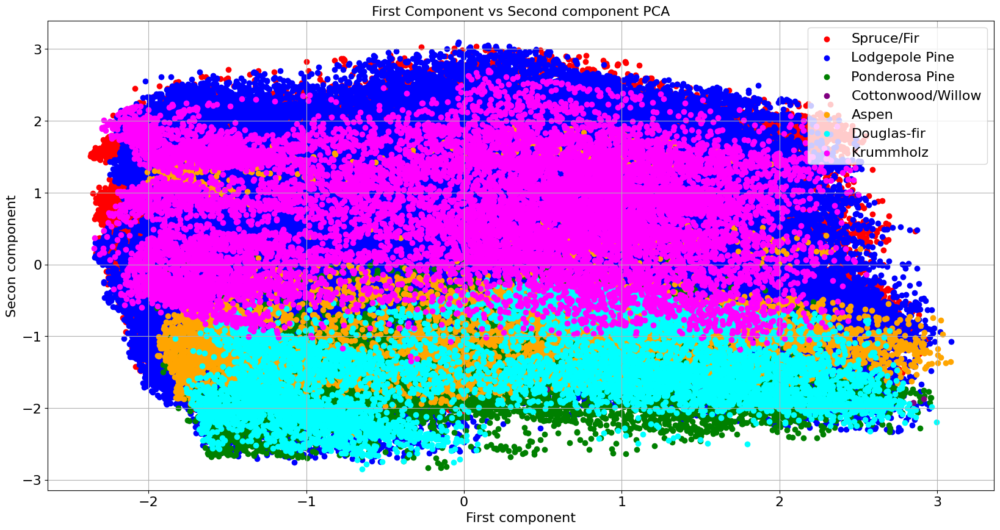

In [53]:
fig, ax = plt.subplots()
fig.set_size_inches(20,10)
_=plt.scatter(class_label1['first-component'], class_label1['second-component'], color = 'red', label = 'Spruce/Fir')
_=plt.scatter(class_label2['first-component'], class_label2['second-component'], color = 'blue', label = 'Lodgepole Pine')
_=plt.scatter(class_label3['first-component'], class_label3['second-component'], color = 'green', label = 'Ponderosa Pine')
_=plt.scatter(class_label4['first-component'], class_label4['second-component'], color = 'purple', label = 'Cottonwood/Willow')
_=plt.scatter(class_label5['first-component'], class_label5['second-component'], color = 'orange', label = 'Aspen')
_=plt.scatter(class_label6['first-component'], class_label6['second-component'], color = 'cyan', label = 'Douglas-fir')
_=plt.scatter(class_label7['first-component'], class_label7['second-component'], color = 'magenta', label = 'Krummholz')


plt.legend(fontsize=16)
plt.grid()
plt.xlabel('First component',fontsize=16);
plt.ylabel('Secon component', fontsize=16);
plt.title('First Component vs Second component PCA',fontsize=16);
plt.xticks(fontsize=16);
plt.yticks(fontsize=16);


In [54]:
new_df

,elevation,aspect,slope,horizontal_distance_to_hydrology,vertical_distance_to_hydrology,horizontal_distance_to_roadways,hillshade_noon,hillshade_3pm,horizontal_distance_to_fire_points,wilderness_area1,...,soil_type34,soil_type35,soil_type36,soil_type37,soil_type38,soil_type39,soil_type40,cover_type,first-component,second-component
10,-0.262036,-0.041612,-0.414480,0.477874,-0.350268,1.861693,0.843824,-0.170564,1.563769,1,...,0,0,0,0,0,0,0,2,-0.203476,2.068787
34,-0.212033,-0.988771,0.653863,-0.129044,-0.453192,1.827061,-1.432502,-1.111137,1.612100,1,...,0,0,0,0,0,0,0,2,2.112849,2.081788
66,-0.144172,-1.274706,-0.147394,-0.844172,-0.693349,1.905304,-0.471387,-0.013802,1.570565,1,...,0,0,0,0,0,0,0,1,1.168406,2.275988
93,0.066554,-0.756449,-0.548023,0.736637,0.661822,2.175305,-0.117292,-0.562469,1.368176,1,...,0,0,0,0,0,0,0,2,0.793180,2.634971
106,-0.179888,-0.881546,0.253234,-0.637161,-0.401730,2.021385,-1.027822,-1.058883,1.588690,1,...,0,0,0,0,0,0,0,2,1.763713,2.258749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580996,-1.879984,0.110291,1.188035,-0.505427,-0.092957,-1.394995,0.894409,-0.379580,-0.880002,0,...,0,0,0,0,0,0,0,3,0.347947,-2.569502
580997,-1.894270,0.092420,1.321578,-0.547770,-0.024341,-1.403332,0.843824,-0.457961,-0.882268,0,...,0,0,0,0,0,0,0,3,0.446300,-2.606566
580998,-1.904985,0.110291,1.321578,-0.561885,-0.075803,-1.409104,0.894409,-0.405707,-0.883023,0,...,0,0,0,0,0,0,0,3,0.386677,-2.619424
580999,-1.915700,0.119226,1.321578,-0.637161,-0.127265,-1.411028,0.894409,-0.379580,-0.883778,0,...,0,0,0,0,0,0,0,3,0.370207,-2.633101


In [59]:
# _=plt.scatter(class_label1['first-component'], class_label1['second-component'], color = 'red', label = 'Spruce/Fir')
# _=plt.scatter(class_label2['first-component'], class_label2['second-component'], color = 'blue', label = 'Lodgepole Pine')
# _=plt.scatter(class_label3['first-component'], class_label3['second-component'], color = 'green', label = 'Ponderosa Pine')
# _=plt.scatter(class_label4['first-component'], class_label4['second-component'], color = 'purple', label = 'Cottonwood/Willow')
# _=plt.scatter(class_label5['first-component'], class_label5['second-component'], color = 'orange', label = 'Aspen')
# _=plt.scatter(class_label6['first-component'], class_label6['second-component'], color = 'cyan', label = 'Douglas-fir')
# _=plt.scatter(class_label7['first-component'], class_label7['second-component'], color = 'magenta', label = 'Krummholz')

# The goal here is to plot the 3d plot of the two major components against the class label

fig = px.scatter_3d(class_label1, x= 'first-component' , y= 'second-component', z= 'cover_type', color='cover_type')
fig.show()

In [55]:
fig = px.scatter_3d(new_df, x= 'first-component' , y= 'second-component', z= 'cover_type', color='cover_type')
fig.show()

From the scatter plot above and the number of each class in the dataset we can understand that our data does not suffer from data imbalance.

# 3. Models training and evaluation

Since the task at hand is a classification problem, then the following models will be evaluated, and tunned to achieve best accuracy.

  - k-nearest neighbours = to be used as a baseline model.

  - Naive-Bayes classifier

  - Logistic regression

  - Random Forest

  - Decision trees

  - Supper vector machines



In [56]:
X_train,X_test, y_train, y_test = train_test_split(X_reduced,y, test_size = 0.25)
X_train.shape,X_test.shape, y_train.shape, y_test.shape

((298577, 31), (99526, 31), (298577,), (99526,))

In [97]:
model_and_their_scores_dict = {}     # this dictionary is a dictionary that will be used throughout all models used to store their accuracy, precision and recall.

### 3.1 K-nearst neighbours

-To find the optimal prediction we will use several k-neighbors.

- Due to the balanced number number of classes throughout the sample the accuracy performance metric will be used.

- For the covertype classification problem, it can deduced that cost of **false positives** are high. This is due to the fact that if an environment has been labelled incorrectly as suitable for a certain forest type, then all the investment and efforts spent are for nothing.  

In [ ]:
k_candidates = np.arange(1,23,2)    # k - number of kneighbours can only be odd numbers

k_models_dictionary = {}   # a dictionary to store the precision, f1 score and accuracy of k neighbors in the format {"k": test_accuracy, train_accuracy}

for k_instance in k_candidates:
    knn_classifier = KNeighborsClassifier(n_neighbors=k_instance)
    knn_classifier.fit(X_train, y_train)
    knn_classifier_prediction = knn_classifier.predict(X_test)
    # Evaluation scores
    knn_accuracy_test = accuracy_score(y_test, knn_classifier_prediction)
    knn_accuracy_train = accuracy_score(y_test, knn_classifier_prediction)


    k_metric_values = [knn_accuracy_test,knn_accuracy_test]
    k_models_dictionary[k_instance] = k_metric_values
    print(f"\nk = {k_instance}")
    print(f"The accuracy of the knn model on the training set is  is  {knn_accuracy_test}")
    print(f"The accuracy of the knn model on the testing set is {knn_accuracy_train}")




k = 1
The accuracy of the knn model on the training set is  is  0.9352430520667966
The accuracy of the knn model on the testing set is 0.9352430520667966

k = 3
The accuracy of the knn model on the training set is  is  0.9325100978638747
The accuracy of the knn model on the testing set is 0.9325100978638747

k = 5
The accuracy of the knn model on the training set is  is  0.9279585234009203
The accuracy of the knn model on the testing set is 0.9279585234009203

k = 7
The accuracy of the knn model on the training set is  is  0.9230050439081245
The accuracy of the knn model on the testing set is 0.9230050439081245


Plot of the accuracy of the number of components on the training and testing set.

In [ ]:
fig, axs = plt.subplots()
fig.set_size_inches(18,8)

k_accuracy = []
k_precision = []
k_mathew =[]
for ke in (k_models_dictionary.keys()):
  k_accuracy.append(k_models_dictionary[ke][0])
  k_precision.append(k_models_dictionary[ke][1])
  k_mathew.append(k_models_dictionary[ke][2])

plt.plot(list(k_models_dictionary.keys()), np.array(k_accuracy).reshape(-1,1), 'blue', label = "Accuracy")
plt.plot(list(k_models_dictionary.keys()),np.array(k_precision).reshape(-1,1), 'red',label = 'Precision')
plt.xticks(np.arange(1,24,1))
plt.legend()
plt.grid()

From the plot above, the optimal number of neighbors is ______. Consequently, this will be added to the model_and_their_scores_dict to be compared with other algorithms' results.

- K-neighbours classifier's accuracy will be used as a baseline to other algorithms.

- Not only the accuracy of the K-NN model will be compared against other algorithms but also the precision and mathew's correlation coefficient.

In [ ]:
k_optimal =

knn_classifier = KNeighborsClassifier(n_neighbors=k_optimal)
knn_classifier.fit(X_train, y_train)
knn_classifier_prediction = knn_classifier.predict(X_test)

# Evaluation scores
knn_accuracy_test = accuracy_score(y_test, knn_classifier_prediction)
knn_precision = precision_score(y_test, knn_classifier_prediction, average='weighted')    # weighted average is
knn_mathew_corre_coeff = matthews_corrcoef(y_test, knn_classifier_prediction)
model_and_their_scores_dict['k-NN'] = [knn_accuracy_test, knn_precision, knn_mathew_corre_coeff]
model_and_their_scores_dict

From the several knn neighbour models the optimal one will be selected in the cell below.

- To do so accuracy, precision and mathew's correlation coefficient will be used.  

After an optimal model has been selected, we will see its capability by ploting the auc curve.

In [ ]:
np.unique(knn_classifier_prediction)

In [ ]:
# Evaluation scores
knn_accuracy = accuracy_score(y_test, knn_classifier_prediction)
knn_precision = precision_score(y_test, knn_classifier_prediction, average='micro')
knn_recall = recall_score(y_test, knn_classifier_prediction, average = 'micro')
knn_confusion_matrix = confusion_matrix(y_test, knn_classifier_prediction)
#
print(f"The accuracy of the knn model is  {knn_accuracy}")
print(f"The precision of the knn model is  {knn_precision}")
print(f"The recall of the knn model is  {knn_recall}")
print(f"The confusion matrix of the knn model is \n {knn_confusion_matrix}")

### 3.2 Naive-Bayes Classifier

### 3.3 Logistic Regression

### 3.4 Random forest

From the barchart plot above, it seems that almost all classes have a fairly similar distribution except class 2, which is clearly more prevelant than the rest classes.

### Visualising the **components, features**
   by themselves to see if some are redundant or explain very little variability in our data.

- First we will compute the covariance of the features to observe correlation between features.

- Then the Principal Component Analysis will be applied

- Moreover, similar patterns and variation of two features indicate duplicity so such features are also observed.

In [ ]:
# To better compare the features we will find the zscore dataframe corresponding
df_zscore = df.copy()
df_zscore = stats.zscore(df_zscore)

In [ ]:
df_zscore

Splitting the df_zscore into target and features.

- We shall analyse the features dataframe separately from the target.

- Moreover, dimensionality reduction shall be applied on the features dataframe.

In [ ]:
features_df = df[np.arange(0,54,1)]
target_df = df[54]
target_df

In [ ]:
from sklearn.decomposition import PCA
from tqdm import tqdm


The cell below tries to find the optimal number of components/features using PCA analysis by iterating and the cummulative sum of the data variance explained by the components

In [ ]:
number_of_components = np.arange(1,len(df.columns), 1)   # the range is the same as the number of columns, which are equivalent to features in this case
components_representation_list = {}
X = features_df.values    # df.values()
for i in tqdm(number_of_components):
  instance_pca = PCA(i)
  temp_fit = instance_pca.fit(X)   # we are fitting, the dimension reduction model with the 2D array from lab tasks
  X_temp = temp_fit.transform(X)

  temp_components_ratio = temp_fit.explained_variance_ratio_
  temp_cumsum = (np.cumsum(temp_components_ratio))*100

  components_representation_list[i] = temp_cumsum       # storing the cummulative sum into the dictionary




In [ ]:
components_representation_list

From the output cell above, it is clear that the first four components can explain about 99.9% of the variance of the overall data.

From this two approaches could be attempted:

1. Reducing the components or features reduced to only the number that explains 99.9% of the variance in the data. And training the model only upon this data.
Expectation: the training of the model and the model itself isn't complex. Resuts are expected to either surpass the unreduced components

2. Working with the original dataset/dimension. The results should be crude but the accuracy of prediction can be considered as a base for the reduced data.

In [ ]:
# To determine the number of components we will iterate

smallest_best_no_components = 1
for i in components_representation_list:
  cummulative_variance_of_component = components_representation_list[i][-1]      #the last value is the variance of data explained by the selected number components
  if cummulative_variance_of_component >= 99.9:
    smallest_best_no_components = i
    print(" The smallest number of components that represents 99.9% of the variability in the data is: ", smallest_best_no_components)
    break;




In [ ]:
best_PCA = PCA(smallest_best_no_components)
best_fitted = best_PCA.fit(X)    # fitting our features data to the PCA model with 5 components
pca_transformed = best_fitted.transform(X)  # transforming our data according to the fitted model

reduced_target_df = pd.DataFrame(pca_transformed)


In [ ]:
reduced_target_df

As can be seen from the output above the newly reduced target dataframe contains only 4 features/ dimensions.

The values of the newly reduced and PCA transformed data captures the escence and variation of the original data and are correct mathematical values; however, they don't make sense as they are.

In [ ]:
fig, axs = plt.subplots()
fig.set_size_inches(20,8)

plt.scatter(df.index, df[1], color='indianred', edgecolors='r', alpha = 0.01)
plt.scatter(df.index, df[2], color='royalblue', edgecolors='b', alpha = 0.01)
# plt.scatter(df.index, df[3], color='mediumseagreen', edgecolors='g')
plt.xlabel('Date',fontsize=12);
plt.legend()